# Kaggle Project

dataset:https://www.kaggle.com/uciml/wall-following-robot
https://archive.ics.uci.edu/ml/machine-learning-databases/00194/

# Describe Your Dataset

#### Sensor readings from a wall-following robot

##### The Task:
The wall-following task and data gathering were designed to test the hypothesis that this apparently simple navigation task is indeed a non-linearly separable classification task. Thus, linear classifiers, such as the Perceptron network, are not able to learn the task and command the robot around the room without collisions. Nonlinear neural classifiers, such as the MLP network, are able to learn the task and command the robot successfully without collisions.

If some kind of short-term memory mechanism is provided to the neural classifiers, their performances are improved in general. For example, if past inputs are provided together with current sensor readings, even the Perceptron becomes able to learn the task and command the robot successfully. If a recurrent neural network, such as the Elman network, is used to learn the task, the resulting dynamical classifier is able to learn the task using less hidden neurons than the MLP network.

##### The Datasets:
The data were collected as the SCITOS G5 navigated through the room following the wall in a clockwise direction, for 4
rounds. To navigate, the robot uses 24 ultrasound sensors arranged circularly around its "waist". The numbering of the ultrasound sensors starts at the front of the robot and increases in clockwise direction.

The data contains the raw values of the measurements of all 24 ultrasound sensors and the corresponding class label (Moving forward, turning left, etc). Sensor readings are sampled at a rate of 9 samples per second.

It is worth mentioning that the 24 ultrasound readings and the simplified distances were collected at the same time step, so each file has the same number of rows (one for each sampling time step).

###### Train dataset: 50% of the dataset provided

###### Validation dataset: same as Train dataset

###### Test dataset: 50% of the dataset left


###### Features:
File sensor_readings_24.csv:

US1: ultrasound sensor at the front of the robot (reference angle: 180°) - (numeric: real)
US2: ultrasound reading (reference angle: -165°) - (numeric: real)
US3: ultrasound reading (reference angle: -150°) - (numeric: real)
US4: ultrasound reading (reference angle: -135°) - (numeric: real)
US5: ultrasound reading (reference angle: -120°) - (numeric: real)
US6: ultrasound reading (reference angle: -105°) - (numeric: real)
US7: ultrasound reading (reference angle: -90°) - (numeric: real)
US8: ultrasound reading (reference angle: -75°) - (numeric: real)
US9: ultrasound reading (reference angle: -60°) - (numeric: real)
US10: ultrasound reading (reference angle: -45°) - (numeric: real)
US11: ultrasound reading (reference angle: -30°) - (numeric: real)
US12: ultrasound reading (reference angle: -15°) - (numeric: real)
US13: reading of ultrasound sensor situated at the back of the robot (reference angle: 0°) - (numeric: real)
US14: ultrasound reading (reference angle: 15°) - (numeric: real)
US15: ultrasound reading (reference angle: 30°) - (numeric: real)
US16: ultrasound reading (reference angle: 45°) - (numeric: real)
US17: ultrasound reading (reference angle: 60°) - (numeric: real)
US18: ultrasound reading (reference angle: 75°) - (numeric: real)
US19: ultrasound reading (reference angle: 90°) - (numeric: real)
US20: ultrasound reading (reference angle: 105°) - (numeric: real)
US21: ultrasound reading (reference angle: 120°) - (numeric: real)
US22: ultrasound reading (reference angle: 135°) - (numeric: real)
US23: ultrasound reading (reference angle: 150°) - (numeric: real)
US24: ultrasound reading (reference angle: 165°) - (numeric: real)
Classes: Move-Forward, Slight-Right-Turn, Sharp-Right-Turn, Slight-Left-Turn

###### Targets:
Use these ultrasound readings to predict the class, i.e. given these readings, is the robot moving straight? turning left?



# Build Your Model

### Data preprocessing

In [10]:
import numpy as np
import pandas as pd
import seaborn as sb
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.neural_network import MLPClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import accuracy_score,classification_report, confusion_matrix
import matplotlib.pyplot as plt
%matplotlib inline

adding headers to all the 24 sensors and the class variable


In [11]:
df=pd.read_csv('C:/Users/02445/Downloads/archive/sensor_readings_24.csv', header=None)
headerList = ['S1','S2', 'S3', 'S4', 'S5', 'S6', 'S7', 'S8', 'S9', 'S10', 'S11', 'S12', 'S13', 'S14', 'S15', 'S16', 'S17', 'S18', 'S19', 'S20', 'S21' ,'S22', 'S23', 'S24','class'  ]
df.to_csv("newsensor_readings_24.csv", header=headerList, index=False)
df2 = pd.read_csv("newsensor_readings_24.csv")

In [12]:
df2

,S1,S2,S3,S4,S5,S6,S7,S8,S9,S10,...,S16,S17,S18,S19,S20,S21,S22,S23,S24,class
0,0.438,0.498,3.625,3.645,5.000,2.918,5.000,2.351,2.332,2.643,...,0.593,0.502,0.493,0.504,0.445,0.431,0.444,0.440,0.429,Slight-Right-Turn
1,0.438,0.498,3.625,3.648,5.000,2.918,5.000,2.637,2.332,2.649,...,0.592,0.502,0.493,0.504,0.449,0.431,0.444,0.443,0.429,Slight-Right-Turn
2,0.438,0.498,3.625,3.629,5.000,2.918,5.000,2.637,2.334,2.643,...,0.593,0.502,0.493,0.504,0.449,0.431,0.444,0.446,0.429,Slight-Right-Turn
3,0.437,0.501,3.625,3.626,5.000,2.918,5.000,2.353,2.334,2.642,...,0.593,0.502,0.493,0.504,0.449,0.431,0.444,0.444,0.429,Slight-Right-Turn
4,0.438,0.498,3.626,3.629,5.000,2.918,5.000,2.640,2.334,2.639,...,0.592,0.502,0.493,0.504,0.449,0.431,0.444,0.441,0.429,Slight-Right-Turn
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5451,0.910,5.000,3.997,2.785,2.770,2.572,2.433,1.087,1.772,1.040,...,0.660,0.648,0.657,0.686,5.000,1.045,5.000,5.000,1.562,Move-Forward
5452,0.926,5.000,4.015,2.792,2.777,2.571,1.768,1.071,1.762,1.021,...,0.652,0.640,0.649,1.593,1.616,1.058,5.000,5.000,1.085,Sharp-Right-Turn
5453,0.937,5.000,4.034,2.799,2.784,2.571,1.754,1.053,1.752,1.002,...,0.648,0.633,0.642,0.741,5.000,1.065,5.000,5.000,1.105,Sharp-Right-Turn
5454,0.945,4.052,4.052,2.809,2.791,2.441,1.757,1.034,1.743,0.983,...,0.641,0.626,0.635,0.754,5.000,1.076,5.000,5.000,1.118,Move-Forward


In [13]:
df2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5456 entries, 0 to 5455
Data columns (total 25 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   S1      5456 non-null   float64
 1   S2      5456 non-null   float64
 2   S3      5456 non-null   float64
 3   S4      5456 non-null   float64
 4   S5      5456 non-null   float64
 5   S6      5456 non-null   float64
 6   S7      5456 non-null   float64
 7   S8      5456 non-null   float64
 8   S9      5456 non-null   float64
 9   S10     5456 non-null   float64
 10  S11     5456 non-null   float64
 11  S12     5456 non-null   float64
 12  S13     5456 non-null   float64
 13  S14     5456 non-null   float64
 14  S15     5456 non-null   float64
 15  S16     5456 non-null   float64
 16  S17     5456 non-null   float64
 17  S18     5456 non-null   float64
 18  S19     5456 non-null   float64
 19  S20     5456 non-null   float64
 20  S21     5456 non-null   float64
 21  S22     5456 non-null   float64
 22  

In [14]:
df2.describe()

,S1,S2,S3,S4,S5,S6,S7,S8,S9,S10,...,S15,S16,S17,S18,S19,S20,S21,S22,S23,S24
count,5456.000000,5456.000000,5456.000000,5456.000000,5456.000000,5456.000000,5456.000000,5456.000000,5456.000000,5456.000000,...,5456.000000,5456.000000,5456.000000,5456.000000,5456.00000,5456.000000,5456.000000,5456.000000,5456.000000,5456.000000
mean,1.471617,2.327043,2.489347,2.796501,2.958552,2.893073,3.351113,2.540397,3.125621,2.832386,...,2.205772,1.202111,0.989831,0.910273,1.05811,1.076320,1.015923,1.778034,1.555045,1.578508
std,0.802801,1.410146,1.247435,1.309368,1.339225,1.282575,1.413692,1.111554,1.356965,1.307843,...,1.715435,1.098568,0.942075,0.889527,1.14463,1.141498,0.887439,1.571686,1.291447,1.150480
min,0.400000,0.437000,0.470000,0.833000,1.120000,1.114000,1.122000,0.859000,0.836000,0.810000,...,0.495000,0.424000,0.373000,0.354000,0.34000,0.355000,0.380000,0.370000,0.367000,0.377000
25%,0.921000,1.362000,1.538750,1.731000,1.774000,1.785750,1.930750,1.618000,1.799750,1.636000,...,0.860000,0.690000,0.581000,0.529750,0.52300,0.541750,0.567000,0.743000,0.792000,0.884000
50%,1.335000,1.904500,2.064000,2.458000,2.667000,2.682500,3.225500,2.172000,2.802000,2.679000,...,1.328500,0.803000,0.738000,0.685000,0.69100,0.693000,0.764000,1.030500,1.071000,1.289000
75%,1.814000,2.681500,2.739250,4.093500,4.314500,3.835250,5.000000,3.193000,5.000000,3.526250,...,4.436250,1.159000,0.913000,0.837000,0.85700,0.863000,1.002250,2.068250,1.559500,1.657250
max,5.000000,5.025000,5.029000,5.017000,5.000000,5.005000,5.008000,5.087000,5.000000,5.022000,...,5.000000,5.000000,5.000000,5.000000,5.00000,5.000000,5.000000,5.000000,5.000000,5.000000


In [15]:
df2.shape

(5456, 25)

In [16]:
df2.isnull().sum()

S1       0
S2       0
S3       0
S4       0
S5       0
S6       0
S7       0
S8       0
S9       0
S10      0
S11      0
S12      0
S13      0
S14      0
S15      0
S16      0
S17      0
S18      0
S19      0
S20      0
S21      0
S22      0
S23      0
S24      0
class    0
dtype: int64

D:\anaconda\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


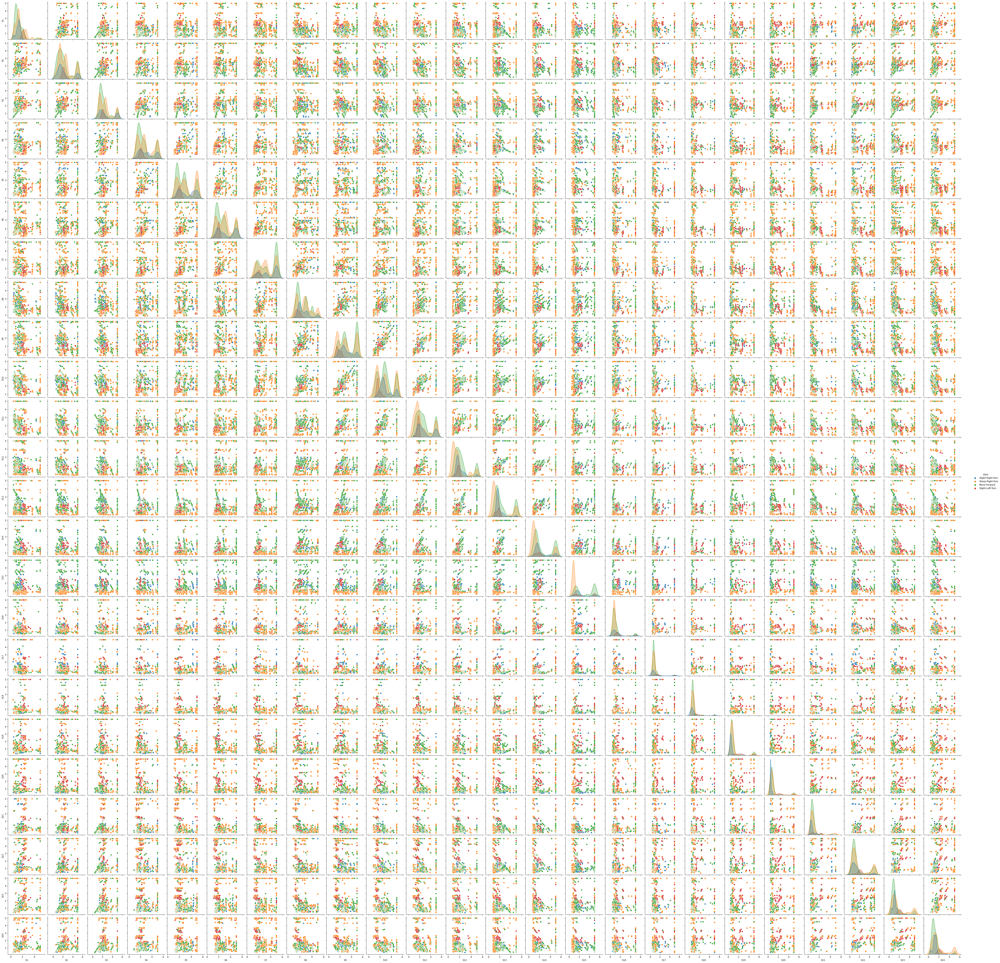

In [17]:
sb.pairplot(df2,hue='class')

In [18]:
sb.heatmap(df2.corr()) 
plt.show()

ValueError: could not convert string to float: 'Slight-Right-Turn'

assigning input attributes and output attributes separately

In [19]:
X=df2.drop(['class'],axis=1)
y=df2['class']

### Model Construction, Train & Test

#### logistic regression

In [20]:
X_train, X_test, y_train, y_test = train_test_split(X,y,test_size=0.5)##50:50 train:test ratio
logistic = LogisticRegression()
logistic.fit(X_train,y_train)
y_predict = logistic.predict(X_test)
y_predict = logistic.predict(X_test)

D:\anaconda\Lib\site-packages\sklearn\linear_model\_logistic.py:460: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


In [21]:
LRAcc = accuracy_score(y_test, y_predict)
print('Accuracy:',LRAcc)
print('Classification Report',classification_report(y_test,y_predict))

Accuracy: 0.7012463343108505
Classification Report                    precision    recall  f1-score   support

     Move-Forward       0.74      0.71      0.73      1100
 Sharp-Right-Turn       0.68      0.78      0.73      1062
 Slight-Left-Turn       0.59      0.51      0.55       173
Slight-Right-Turn       0.69      0.53      0.60       393

         accuracy                           0.70      2728
        macro avg       0.68      0.63      0.65      2728
     weighted avg       0.70      0.70      0.70      2728



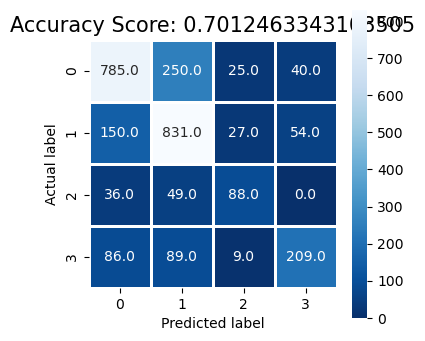

In [22]:
plt.figure(figsize=(4,4))
sb.heatmap(confusion_matrix(y_test,y_predict), annot=True, fmt=".1f", linewidths=.90, square = True, cmap = 'Blues_r');
plt.ylabel('Actual label');
plt.xlabel('Predicted label');
all_sample_title = 'Accuracy Score: {0}'.format(accuracy_score(y_test, y_predict))
plt.title(all_sample_title, size = 15);

#### Decision Tree Classifier

In [23]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.5)##50:50 train:test ratio
tree=DecisionTreeClassifier(criterion="entropy")
tree.fit(X_train,y_train)
treeprediction=tree.predict(X_test)

In [24]:
DTCAcc = accuracy_score(y_test,treeprediction)
print('Accuracy:', DTCAcc)
print('Classification Report',classification_report(y_test,treeprediction))

Accuracy: 0.9919354838709677
Classification Report                    precision    recall  f1-score   support

     Move-Forward       1.00      0.99      0.99      1094
 Sharp-Right-Turn       0.99      1.00      0.99      1052
 Slight-Left-Turn       1.00      0.98      0.99       167
Slight-Right-Turn       0.98      0.99      0.98       415

         accuracy                           0.99      2728
        macro avg       0.99      0.99      0.99      2728
     weighted avg       0.99      0.99      0.99      2728



#### Naive Bayes

In [25]:
X_train,X_test,y_train,y_test = train_test_split(X,y,test_size=0.5)##50:50 train:test ratio
gnb = GaussianNB()
gnb.fit(X_train,y_train)
y_pred=gnb.predict(X_test)

In [26]:
NBAcc = accuracy_score(y_test,y_pred)
print("Accuracy is :", NBAcc)
print('Classification Report',classification_report(y_test,y_pred))

Accuracy is : 0.5590175953079178
Classification Report                    precision    recall  f1-score   support

     Move-Forward       0.71      0.46      0.55      1102
 Sharp-Right-Turn       0.71      0.49      0.58      1038
 Slight-Left-Turn       0.50      0.91      0.64       170
Slight-Right-Turn       0.36      0.86      0.51       418

         accuracy                           0.56      2728
        macro avg       0.57      0.68      0.57      2728
     weighted avg       0.64      0.56      0.56      2728



#### Multilayer Perception (MLP)

In [27]:
X_train, X_test, y_train, y_test = train_test_split(X, y,test_size=0.5)##50:50 train:test ratio
MLP = MLPClassifier(max_iter=500, activation='relu')
MLP.fit(X_train,y_train)
prediction = MLP.predict(X_test)

D:\anaconda\Lib\site-packages\sklearn\neural_network\_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (500) reached and the optimization hasn't converged yet.
  warnings.warn(


In [28]:
MLPAcc = accuracy_score(y_test,prediction)
print("Accuracy is :", MLPAcc)
print('Classification Report',classification_report(y_test,prediction))

Accuracy is : 0.9303519061583577
Classification Report                    precision    recall  f1-score   support

     Move-Forward       0.93      0.92      0.92      1091
 Sharp-Right-Turn       0.93      0.96      0.95      1047
 Slight-Left-Turn       0.94      0.89      0.92       171
Slight-Right-Turn       0.92      0.90      0.91       419

         accuracy                           0.93      2728
        macro avg       0.93      0.92      0.92      2728
     weighted avg       0.93      0.93      0.93      2728



### Performance

In [37]:
print("Accuracy for Logistic Regression is :", LRAcc)
print("Accuracy for Decision Tree Classifier is :", DTCAcc)
print("Accuracy for Naive Bayes is :", NBAcc)
print("Accuracy for Multilayer Perception is :", MLPAcc)

Accuracy for Logistic Regression is : 0.7012463343108505
Accuracy for Decision Tree Classifier is : 0.9919354838709677
Accuracy for Naive Bayes is : 0.5590175953079178
Accuracy for Multilayer Perception is : 0.9303519061583577


among all the machine learning algorithms used decision tree gives with the high accuracy of 0.99 in train:test ratio 50:50 ratio and naive bayes gives the least accuracy of 0.55 in train:test ratio 50:50 ratio